In [61]:
!pip install lime

In [2]:
import lime

In [3]:
import sklearn
import sklearn.datasets
import sklearn.ensemble
import numpy as np
import lime
import lime.lime_tabular
from __future__ import print_function
np.random.seed(1)

# Example

In [ ]:
iris = sklearn.datasets.load_iris()

In [ ]:
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(iris.data, iris.target, train_size=0.80)

In [ ]:
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(iris.data, iris.target, train_size=0.80)
print(train[:10])

[[6.6 3.  4.4 1.4]
 [6.3 2.3 4.4 1.3]
 [5.1 3.7 1.5 0.4]
 [6.5 3.2 5.1 2. ]
 [5.7 3.  4.2 1.2]
 [4.8 3.  1.4 0.1]
 [6.3 3.4 5.6 2.4]
 [4.8 3.1 1.6 0.2]
 [7.7 2.6 6.9 2.3]
 [6.4 2.8 5.6 2.2]]


In [ ]:
rf = sklearn.ensemble.RandomForestClassifier(n_estimators=500)
rf.fit(train, labels_train)

RandomForestClassifier(n_estimators=500)

In [ ]:
sklearn.metrics.accuracy_score(labels_test, rf.predict(test))

0.9666666666666667

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=iris.feature_names, class_names=iris.target_names, discretize_continuous=True, ) #kernel_width

In [ ]:
i = np.random.randint(0, test.shape[0])
exp = explainer.explain_instance(test[i], rf.predict_proba, num_features=2, top_labels=1)

In [ ]:
rf.predict_proba(train[:10])

array([[0.   , 1.   , 0.   ],
       [0.   , 0.996, 0.004],
       [1.   , 0.   , 0.   ],
       [0.   , 0.026, 0.974],
       [0.   , 1.   , 0.   ],
       [1.   , 0.   , 0.   ],
       [0.   , 0.002, 0.998],
       [1.   , 0.   , 0.   ],
       [0.   , 0.   , 1.   ],
       [0.   , 0.   , 1.   ]])

In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
iris.feature_names

['sepal length (cm)',
 'sepal width (cm)',
 'petal length (cm)',
 'petal width (cm)']

In [ ]:
iris.target_names

array(['setosa', 'versicolor', 'virginica'], dtype='<U10')

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=iris.feature_names, class_names=iris.target_names, discretize_continuous=True, kernel_width=0.1)


In [ ]:
i = np.random.randint(0, test.shape[0])
print(i, test[i])
exp = explainer.explain_instance(test[i], rf.predict_proba, num_features=2, top_labels=1)

10 [6.5 3.  5.8 2.2]


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.0


# Co-related data or non-Linear function


## ReLU

In [6]:
import numpy as np

def relu(inputs):
  results = []
  print(len(inputs), inputs)
  for input in  inputs:
    x, y = input
    y_ = np.maximum(0, x)
    if y_ > y:  results.append([0.99, 0.01]) #down
    else:  results.append([0.01, 0.99]) #up
  return np.array(results)

In [18]:
# Scale the number to the desired range [a, b)
a = 5
b = 10
y = np.random.random(size=(5,2)) * (b - a) + a

In [19]:
y

array([[6.41703553, 9.43550712],
       [9.71870046, 6.35922205],
       [5.83977367, 5.24060287],
       [7.65337971, 9.20992779],
       [5.39925779, 8.65854525]])

In [20]:
feature_names = ['x', 'y']
target_names = ['down', 'up']

In [21]:
explainer = lime.lime_tabular.LimeTabularExplainer(y, feature_names=feature_names, class_names=target_names, discretize_continuous=True)

In [22]:
test = np.random.random(size=(2)) * (b - a) + a #np.array([0,0])
exp = explainer.explain_instance(test, relu, num_features=2)#, top_labels=1)

5000 [[6.24028891 7.5272314 ]
 [5.64322837 8.65854525]
 [6.41703553 5.99403783]
 ...
 [6.41703553 9.43550712]
 [9.71870046 6.00276536]
 [5.76946533 5.25726882]]


In [23]:
exp.show_in_notebook(show_table=True, show_all=False)

In [24]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
6.36 < y <= 8.66: 0.27701893648882037
5.84 < x <= 6.42: 0.04319540762600324


In [25]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.07059203630612121


In [16]:
test = np.array([0.01,0.01])
exp = explainer.explain_instance(test, relu, num_features=2)#, top_labels=1)

5000 [[ 0.01        0.01      ]
 [-8.97773875 -6.64766245]
 [-7.91347599 -7.94303987]
 ...
 [-8.97773875 -6.5739025 ]
 [-7.91347599 -8.31740472]
 [-7.91347599 -8.97406948]]


In [17]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")
print(f"Local fidelity (R^2): {exp.score}")

LIME Feature Importance:
x > -7.91: 0.0014668015867986331
y > -6.57: 0.0014362029300998046
Local fidelity (R^2): 0.002152612950561017


## ReLU co-realted

In [5]:
import numpy as np

def co_relu(inputs):
  results = []
  print(len(inputs), inputs)
  for input in  inputs:
    x, y = input
    y_ = np.maximum(0, x)
    if y_ > y :  results.append([0.99, 0.01]) #down
    else:  results.append([0.01, 0.99]) #up
  return np.array(results)

In [ ]:
test = np.random.random(size=(1)) * (b - a) + a #np.array([0,0])
A = np.random.random(size=(1))[0]
print(A)
test = np.array([test[0], test[0] + A])

exp = explainer.explain_instance(test, co_relu, num_features=2)#, top_labels=1)

0.6427257926016517
5000 [[-6.57208174 -5.92935595]
 [-7.50299747 -5.09071238]
 [ 6.6515649  -8.31449543]
 ...
 [ 6.6515649  -5.09071238]
 [-5.44254025 -4.85658353]
 [-6.97654609 -6.92443544]]


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
y <= -5.62: -0.21782334912288454
x <= -4.85: 0.10790024909380537


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.15882478305748216


In [ ]:
test = np.random.random(size=(1)) * (b - a) + a #np.array([0,0])
A = np.random.random(size=(1))[0]
print(A)
test = np.array([test[0], test[0] + A])

exp = explainer.explain_instance(test, co_relu, num_features=2)#, top_labels=1)

0.3648899917530969
5000 [[ 3.65789454  4.02278454]
 [-6.42421969 -8.12859399]
 [ 9.24076499 -7.67393012]
 ...
 [ 8.3122804  -5.09071238]
 [ 9.24076499 -4.85658353]
 [ 9.24076499 -6.99296176]]


In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

print(f"Local fidelity (R^2): {exp.score}")

LIME Feature Importance:
y > -4.86: 0.6136289956233012
-4.85 < x <= 6.65: 0.13834347750811046
Local fidelity (R^2): 0.5717904640931958


## ReLU with three feature

In [ ]:
import numpy as np

def three_relu(inputs):
  results = []
  print(len(inputs), inputs)
  for input in  inputs:
    x, y, z = input
    y_ = np.maximum(0, x)
    if y_ > y :  results.append([0.99, 0.01]) #down
    else:  results.append([0.01, 0.99]) #up
  return np.array(results)

In [ ]:
# Scale the number to the desired range [a, b)
a = -10
b = 10
y = np.random.random(size=(5,3)) * (b - a) + a

In [ ]:
feature_names = ['x', 'y', 'z']
target_names = ['down', 'up']

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(y, feature_names=feature_names, class_names=target_names, discretize_continuous=True)

In [ ]:
test = np.random.random(size=(3)) * (b - a) + a #np.array([0,0, 0])

exp = explainer.explain_instance(test, three_relu, num_features=2) #, top_labels=1)

5000 [[ 5.60254991 -7.5345072  -6.68351168]
 [ 7.85934163  2.89222033 -2.70418951]
 [-1.68627876  4.44230186 -5.8338338 ]
 ...
 [-1.68627876  1.24617336 -5.96813673]
 [-3.71033967 -7.77682661  0.15901713]
 [-5.39948692  2.89222033 -5.83102015]]


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
y <= 0.14: -0.7193423339228954
x > -1.69: -0.5252500583092475


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.7892189676194444


In [ ]:
test = np.random.random(size=(3)) * (b - a) + a #np.array([0,0, 0])

exp = explainer.explain_instance(test, three_relu, num_features=2) #, top_labels=1)

5000 [[-1.57862823  6.33995443 -0.53671941]
 [-1.68627876  1.24617336  0.15901713]
 [ 7.85934163  4.44230186  0.15901713]
 ...
 [-5.99048615  2.89222033 -5.70440546]
 [ 7.85934163  1.24617336 -5.94234931]
 [-5.54415982 -6.59949289 -2.70418951]]


In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")
print(f"Local fidelity (R^2): {exp.score}")

LIME Feature Importance:
x > -1.69: -0.6026885749416022
y > 2.89: 0.37906181460413824
Local fidelity (R^2): 0.38740544555396716


##  more complex non-linear function

In [ ]:
import numpy as np

def interesting_func(inputs):
  results = []
  print(len(inputs), inputs)
  for input in  inputs:
    x, y = input
    if x < 0:
      y_ = x**2
    else:
      y_ = x* -1
    if y_ > y:  results.append([0.99, 0.01]) #down
    else:  results.append([0.01, 0.99]) #up
  return np.array(results)

In [ ]:
# Scale the number to the desired range [a, b)
a = -10
b = 10
y = np.random.random(size=(5,2)) * (b - a) + a

In [ ]:
feature_names = ['x', 'y']
target_names = ['down', 'up']

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(y, feature_names=feature_names, class_names=target_names, discretize_continuous=True)

In [ ]:
test = np.random.random(size=(2)) * (b - a) + a  #np.array([0,0])
exp = explainer.explain_instance(test, interesting_func, num_features=1)#, top_labels=1)

5000 [[-6.70305593  3.47208576]
 [ 6.55816738 -1.40161209]
 [ 1.29812523  8.84831843]
 ...
 [ 8.4618799   0.03612805]
 [ 6.55816738 -5.4692728 ]
 [ 6.55816738 -1.40161209]]


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
x <= 2.74: -0.7392999018975503


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.6057137499316548


In [ ]:
test = np.random.random(size=(2)) * (b - a) + a  #np.array([0,0])
exp = explainer.explain_instance(test, interesting_func, num_features=1)#, top_labels=1)

5000 [[ 9.50243786  0.48142748]
 [ 1.87767451 -5.35457575]
 [ 6.75133064 -5.41213889]
 ...
 [ 8.4618799  -5.33701434]
 [ 6.75133064 -5.31670457]
 [ 6.55816738 -5.47517091]]


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
x > 6.75: 0.3770764972274053


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.1543688910007004


## Random Forest

In [ ]:
import pandas as pd
# Generate synthetic dataset with correlated features
np.random.seed(42)
n_samples = 1000
F1 = np.random.uniform(0, 10, n_samples)
F2 = np.random.uniform(0, 10, n_samples) #F1 + np.random.normal(0, 0.5, n_samples)  # Correlated with F1
labels = (F1 + F2 > 10).astype(int)  # Simple threshold-based classification

# Combine into a DataFrame
data = pd.DataFrame({'F1': F1, 'F2': F2})
train_data, train_labels = data[:800], labels[:800]
test_data, test_labels = data[800:], labels[800:]

# Train a Random Forest model
rf = sklearn.ensemble.RandomForestClassifier(random_state=42)
rf.fit(train_data, train_labels)

# Apply LIME
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=train_data.values,
    feature_names=['F1', 'F2'],
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

In [ ]:
# Explain a prediction
instance = test_data.iloc[np.random.randint(100)].values
labels = (instance[0] + instance[1] > 10).astype(int)
print(instance, labels)
exp = explainer.explain_instance(instance, rf.predict_proba, num_features=2)

[4.52439516 6.0188159 ] 1


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
5.17 < F2 <= 7.61: 0.16516758879389062
2.41 < F1 <= 5.07: -0.1318048638480687


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.04756707754337697


^^^^ explain does not really make sense

## Random Forest, corelated data

In [ ]:
import pandas as pd
# Generate synthetic dataset with correlated features
np.random.seed(42)
n_samples = 1000
F1 = np.random.uniform(0, 10, n_samples)
F2 = F1 + np.random.normal(0, 0.5, n_samples)  # Correlated with F1
labels = (F1 + F1 > 10).astype(int)  # Simple threshold-based classification

# Combine into a DataFrame
data = pd.DataFrame({'F1': F1, 'F2': F2})
train_data, train_labels = data[:800], labels[:800]
test_data, test_labels = data[800:], labels[800:]

# Train a Random Forest model
rf = sklearn.ensemble.RandomForestClassifier(random_state=42)
rf.fit(train_data, train_labels)

# Apply LIME
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=train_data.values,
    feature_names=['F1', 'F2'],
    class_names=['Class 0', 'Class 1'],
    mode='classification'
)

In [ ]:
# Explain a prediction
instance = test_data.iloc[np.random.randint(100)].values
labels = (instance[0] + instance[1] > 10).astype(int)
print(instance, labels)
exp = explainer.explain_instance(instance, rf.predict_proba, num_features=2)

[4.50839371 4.0945986 ] 0


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [ ]:
exp.show_in_notebook(show_table=True, show_all=False)

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
2.41 < F1 <= 5.07: -0.5292444839497867
2.36 < F2 <= 5.15: -0.11764417122169502


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.3868565587692335


## Random forest 4 features

In [33]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from lime.lime_tabular import LimeTabularExplainer

# Create a dataset with multiple correlated features
np.random.seed(42)
size = 1000
X1 = np.random.uniform(0, 10, size) #np.random.rand(size)
X2 = X1 + np.random.normal(0, 1, size)  # Highly correlated with X1
X3 = X1 + np.random.normal(0, 0.01, size)  # Also highly correlated with X1
X4 = np.random.rand(size)  # Independent feature
y = (X1 > 0.5).astype(int)  # Only X1 determines the target

# Combine into a DataFrame
X = np.column_stack((X1, X2, X3, X4))
df = pd.DataFrame(X, columns=["Feature1", "Feature2", "Feature3", "Feature4"])

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Apply LIME
explainer = LimeTabularExplainer(
    X_train,
    feature_names=["Feature1", "Feature2", "Feature3", "Feature4"],
    class_names=["0", "1"],
    mode="classification"
)

# Explain an instance
instance_to_explain = X_test[0]
exp = explainer.explain_instance(instance_to_explain, model.predict_proba)

# Show explanation
exp.show_in_notebook()

# Check the true feature importance
print("True feature importance (based on target definition):")
print("Feature1 should be most important, others irrelevant.")


True feature importance (based on target definition):
Feature1 should be most important, others irrelevant.


In [34]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
2.40 < Feature1 <= 5.03: 0.01795484505562819
2.40 < Feature3 <= 5.02: 0.017641858681563684
0.48 < Feature4 <= 0.72: 0.004742493935899051
2.44 < Feature2 <= 5.09: 0.003512708267033578


^^^^^^^ breaks only feature 1 maters


In [35]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.011988403109579826


# Nonlinear Decision Boundary

In [36]:
from sklearn.datasets import make_moons
from sklearn.neural_network import MLPClassifier

# Create a dataset with a nonlinear decision boundary
X, y = make_moons(n_samples=1000, noise=0.1, random_state=42)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a neural network
model = MLPClassifier(hidden_layer_sizes=(10,), max_iter=1000, random_state=42)
model.fit(X_train, y_train)



/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(hidden_layer_sizes=(10,), max_iter=1000, random_state=42)

In [42]:
# Apply LIME
explainer = LimeTabularExplainer(X_train, feature_names=["Feature1", "Feature2"], class_names=["0", "1"], mode="classification")
IDX = np.random.randint(200)
print(X_test[IDX], y_test[IDX])
exp = explainer.explain_instance(X_test[IDX], model.predict_proba)

# Show results
exp.show_in_notebook()

[ 0.13269354 -0.1751809 ] 1


In [43]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
-0.22 < Feature2 <= 0.24: 0.3171228390863948
-0.07 < Feature1 <= 0.53: 0.12964124073227154


In [44]:
print(f"Local fidelity (R^2): {exp.score}")


Local fidelity (R^2): 0.16946343422263643


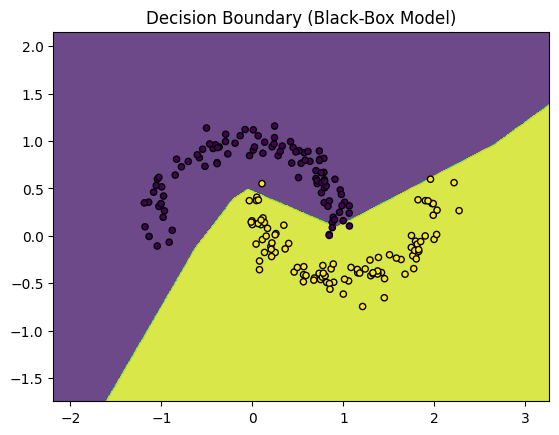

[ 0.13269354 -0.1751809 ]


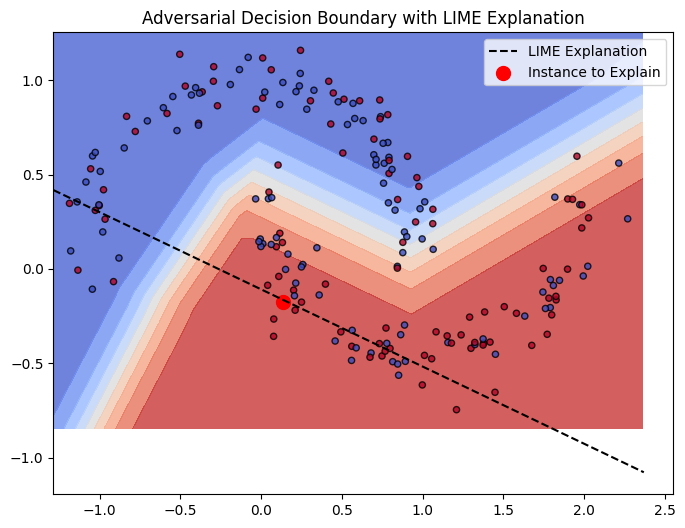

In [59]:
import matplotlib.pyplot as plt
import numpy as np

# Plot the original data and decision boundary
def plot_decision_boundary(model, X, y, ax):
    h = 0.01  # Step size in the mesh
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.8)
    ax.scatter(X[:, 0], X[:, 1], c=y, edgecolor="k", s=20)

# Plot for the black-box model
fig, ax = plt.subplots()
plot_decision_boundary(model, X_test, y_test, ax)
ax.set_title("Decision Boundary (Black-Box Model)")
plt.show()


# Plot decision boundary with LIME's explanation
def plot_decision_boundary_with_lime(model, lime_exp, instance, X, y, ax):
    h = 0.01  # Step size for the grid
    x_min, x_max = X[:, 0].min() - 0.1, X[:, 0].max() + 0.1
    y_min, y_max = X[:, 1].min() - 0.1, X[:, 1].max() + 0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # True decision boundary
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.8, levels=np.linspace(0, 1, 10), cmap="coolwarm")

    # Scatter the data
    ax.scatter(X[:, 0], X[:, 1], c=y, edgecolor="k", cmap="coolwarm", s=20, alpha=0.8)

    # LIME explanation (linear decision boundary)
    # Extract LIME coefficients and intercept
    lime_coeffs = dict(lime_exp.as_map()[1])  # Get feature weights for Class 1
    coef1 = lime_coeffs[0]  # Weight for Feature1
    coef2 = lime_coeffs[1]  # Weight for Feature2
    intercept = lime_exp.intercept[1]  # Intercept for Class 1

    # Calculate line for LIME's decision boundary: coef1 * x + coef2 * y + intercept = 0
    x_vals = np.linspace(x_min, x_max, 100)
    y_vals = -(coef1 * x_vals + intercept) / coef2  + 1.05 # Rearrange for y

    # Plot LIME decision boundary
    ax.plot(x_vals, y_vals, color="black", linestyle="--", label="LIME Explanation")

    # Highlight the instance being explained
    ax.scatter(instance[0], instance[1], color="red", s=100, label="Instance to Explain")

    ax.set_title("Adversarial Decision Boundary with LIME Explanation")
    ax.legend()

# Plot with LIME's explanation
fig, ax = plt.subplots(figsize=(8, 6))
instance_to_explain = X_test[IDX]
print(instance_to_explain)
plot_decision_boundary_with_lime(model, exp, instance_to_explain, X_test, y[800:], ax)
plt.show()



# Adversarial Perturbations

In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin
import random

flip = []
# Define an adversarial model
class AdversarialModel(BaseEstimator, ClassifierMixin):
    def fit(self, X, y):
        return self

    def predict_proba(self, X):
        probs = np.zeros((X.shape[0], 2))
        # Flip predictions arbitrarily based on small changes in data
        probs[:, 1] = (X[:, 0] * X[:, 1] > 0.25).astype(float)
        #flip_mask = np.random.rand(X.shape[0]) < 0.001  # 0.1% random flips
        #flip.extend(np.argwhere(flip_mask==True))
        #probs[flip_mask, 1] = 1 - probs[flip_mask, 1]
        probs[:, 0] = 1 - probs[:, 1]
        return probs


# Create synthetic data
X = np.random.rand(1000, 2)
y = (X[:, 0] * X[:, 1] > 0.25).astype(int)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the adversarial model
model = AdversarialModel()
model.fit(X_train, y_train)



AdversarialModel()

In [ ]:
# Apply LIME
explainer = LimeTabularExplainer(X_train, feature_names=["Feature1", "Feature2"], class_names=["0", "1"], mode="classification")
IDX = np.random.randint(200)
exp = explainer.explain_instance(X_test[IDX], model.predict_proba)

_flip = np.array(flip)
_flip = _flip.flatten()
print(IDX, X_test[IDX], y_test[IDX])

print(np.sort(_flip))
if IDX in _flip:
  print('flipped input')
# Show results
exp.show_in_notebook()


127 [0.20214431 0.14642699] 0
[]


In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")

LIME Feature Importance:
Feature2 <= 0.23: -0.471721670158644
Feature1 <= 0.26: -0.4691491595532707


In [ ]:
print(f"Local fidelity (R^2): {exp.score}")

Local fidelity (R^2): 0.47741016341209874


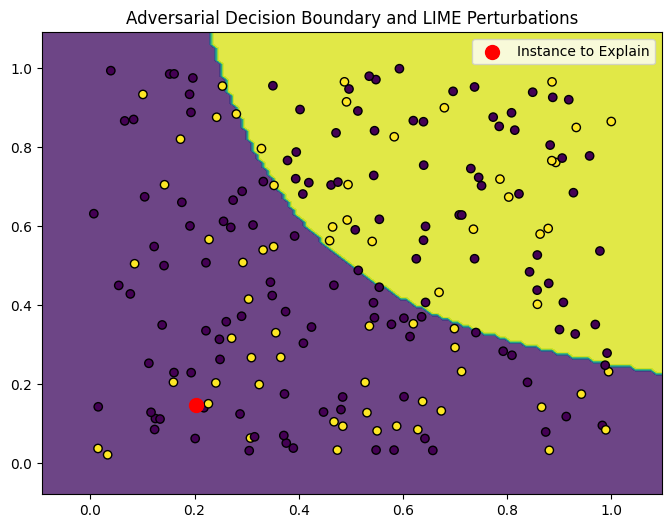

In [ ]:
# Plot decision boundary
def plot_decision_boundary(model, X, y, ax):
    h = 0.01  # Step size
    x_min, x_max = X[:, 0].min() - 0.1, X[:, 0].max() + 0.1
    y_min, y_max = X[:, 1].min() - 0.1, X[:, 1].max() + 0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.8, levels=np.linspace(0, 1, 10))
    ax.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k')

# Visualize true boundary and LIME perturbed samples
# Instance to explain
instance_to_explain = X_test[IDX]
fig, ax = plt.subplots(figsize=(8, 6))
plot_decision_boundary(model, X_test, y[800:], ax)
ax.scatter(instance_to_explain[0], instance_to_explain[1], c="red", s=100, label="Instance to Explain")
ax.set_title("Adversarial Decision Boundary and LIME Perturbations")
plt.legend()
plt.show()

## Add noise

In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin
import random

flip = []
# Define an adversarial model
class AdversarialModel(BaseEstimator, ClassifierMixin):
    def fit(self, X, y):
        return self

    def predict_proba(self, X):
        probs = np.zeros((X.shape[0], 2))
        # Flip predictions arbitrarily based on small changes in data
        probs[:, 1] = (X[:, 0] * X[:, 1] > 0.25).astype(float)
        flip_mask = np.random.rand(X.shape[0]) < 0.01  # 1% random flips
        flip.extend(np.argwhere(flip_mask==True))
        probs[flip_mask, 1] = 1 - probs[flip_mask, 1]
        probs[:, 0] = 1 - probs[:, 1]
        return probs


# Create synthetic data
X = np.random.rand(1000, 2)
y = (X[:, 0] * X[:, 1] > 0.25).astype(int)

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the adversarial model
model = AdversarialModel()
model.fit(X_train, y_train)


AdversarialModel()

In [ ]:
# Apply LIME
explainer = LimeTabularExplainer(X_train, feature_names=["Feature1", "Feature2"], class_names=["0", "1"], mode="classification")
IDX = np.random.randint(200)
exp = explainer.explain_instance(np.array([0.4, 0.5]), model.predict_proba)

_flip = np.array(flip)
_flip = _flip.flatten()
print(IDX, X_test[IDX], y_test[IDX])

print(np.sort(_flip))
if IDX in _flip:
  print('flipped input')
# Show results
exp.show_in_notebook()

71 [0.2370168  0.17005769] 0
[   18    32    39    41    42    44    90    98   102   122   140   149
   150   169   181   192   215   242   259   312   313   330   353   357
   369   373   373   387   408   425   427   436   439   447   472   490
   499   536   537   548   555   633   665   675   723   794   807   858
   863   874   897   918   932   938   947   956   963   985  1005  1022
  1030  1084  1109  1142  1152  1184  1209  1230  1242  1252  1253  1275
  1279  1297  1309  1332  1372  1376  1403  1428  1429  1449  1455  1490
  1529  1596  1600  1620  1628  1646  1647  1658  1662  1665  1685  1685
  1697  1727  1757  1757  1798  1810  1823  1831  1921  1928  1931  1940
  1958  1973  1978  1995  2004  2014  2016  2024  2029  2047  2078  2083
  2118  2129  2160  2183  2185  2193  2199  2208  2209  2213  2214  2220
  2234  2247  2270  2288  2290  2303  2309  2322  2332  2353  2391  2411
  2490  2501  2537  2540  2556  2566  2571  2581  2591  2628  2698  2700
  2731  2746  2767  27

In [ ]:
# Extract feature weights from the explanation
feature_weights = exp.as_list()

# Display feature importance
print("LIME Feature Importance:")
for feature, weight in feature_weights:
    print(f"{feature}: {weight}")
print(f"Local fidelity (R^2): {exp.score}")

LIME Feature Importance:
0.22 < Feature2 <= 0.51: -0.18833920967441742
0.26 < Feature1 <= 0.49: -0.15212829698839858
Local fidelity (R^2): 0.05546602097072406


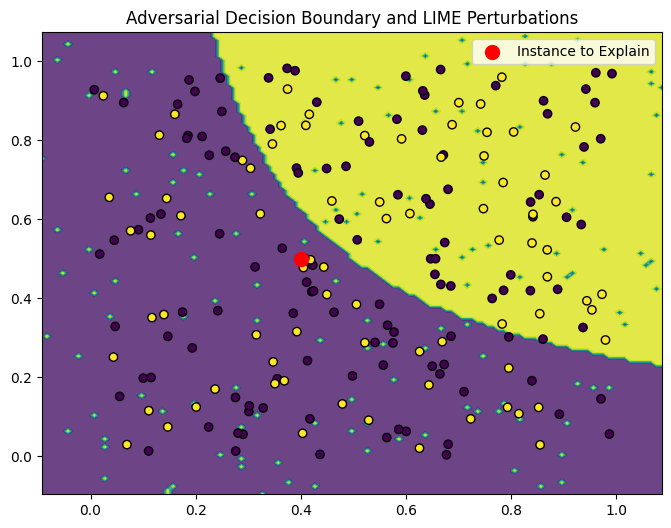

In [ ]:
# Plot decision boundary
def plot_decision_boundary(model, X, y, ax):
    h = 0.01  # Step size
    x_min, x_max = X[:, 0].min() - 0.1, X[:, 0].max() + 0.1
    y_min, y_max = X[:, 1].min() - 0.1, X[:, 1].max() + 0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = model.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, alpha=0.8, levels=np.linspace(0, 1, 10))
    ax.scatter(X[:, 0], X[:, 1], c=y, edgecolor='k')

# Visualize true boundary and LIME perturbed samples
# Instance to explain
instance_to_explain = [0.4, 0.5] #X_test[IDX]
fig, ax = plt.subplots(figsize=(8, 6))
plot_decision_boundary(model, X_test, y[800:], ax)
ax.scatter(instance_to_explain[0], instance_to_explain[1], c="red", s=100, label="Instance to Explain")
ax.set_title("Adversarial Decision Boundary and LIME Perturbations")
plt.legend()
plt.show()

# Code

In [60]:
"""
Contains abstract functionality for learning locally linear sparse model.
"""
from __future__ import print_function
import numpy as np
from sklearn.linear_model import Ridge, lars_path
from sklearn.utils import check_random_state


class LimeBase(object):
    """Class for learning a locally linear sparse model from perturbed data"""
    def __init__(self,
                 kernel_fn,
                 verbose=False,
                 random_state=None):
        """Init function

        Args:
            kernel_fn: function that transforms an array of distances into an
                        array of proximity values (floats).
            verbose: if true, print local prediction values from linear model.
            random_state: an integer or numpy.RandomState that will be used to
                generate random numbers. If None, the random state will be
                initialized using the internal numpy seed.
        """
        self.kernel_fn = kernel_fn
        self.verbose = verbose
        self.random_state = check_random_state(random_state)

    @staticmethod
    def generate_lars_path(weighted_data, weighted_labels):
        """Generates the lars path for weighted data.

        Args:
            weighted_data: data that has been weighted by kernel
            weighted_label: labels, weighted by kernel

        Returns:
            (alphas, coefs), both are arrays corresponding to the
            regularization parameter and coefficients, respectively
        """
        x_vector = weighted_data
        alphas, _, coefs = lars_path(x_vector,
                                     weighted_labels,
                                     method='lasso',
                                     verbose=False)
        return alphas, coefs

    def forward_selection(self, data, labels, weights, num_features):
        """Iteratively adds features to the model"""
        clf = Ridge(alpha=0, fit_intercept=True, random_state=self.random_state)
        used_features = []
        for _ in range(min(num_features, data.shape[1])):
            max_ = -100000000
            best = 0
            for feature in range(data.shape[1]):
                if feature in used_features:
                    continue
                clf.fit(data[:, used_features + [feature]], labels,
                        sample_weight=weights)
                score = clf.score(data[:, used_features + [feature]],
                                  labels,
                                  sample_weight=weights)
                if score > max_:
                    best = feature
                    max_ = score
            used_features.append(best)
        return np.array(used_features)

    def feature_selection(self, data, labels, weights, num_features, method):
        """Selects features for the model. see explain_instance_with_data to
           understand the parameters."""
        if method == 'none':
            return np.array(range(data.shape[1]))
        elif method == 'forward_selection':
            return self.forward_selection(data, labels, weights, num_features)
        elif method == 'highest_weights':
            clf = Ridge(alpha=0, fit_intercept=True,
                        random_state=self.random_state)
            clf.fit(data, labels, sample_weight=weights)
            feature_weights = sorted(zip(range(data.shape[0]),
                                         clf.coef_ * data[0]),
                                     key=lambda x: np.abs(x[1]),
                                     reverse=True)
            return np.array([x[0] for x in feature_weights[:num_features]])
        elif method == 'lasso_path':
            weighted_data = ((data - np.average(data, axis=0, weights=weights))
                             * np.sqrt(weights[:, np.newaxis]))
            weighted_labels = ((labels - np.average(labels, weights=weights))
                               * np.sqrt(weights))
            nonzero = range(weighted_data.shape[1])
            _, coefs = self.generate_lars_path(weighted_data,
                                               weighted_labels)
            for i in range(len(coefs.T) - 1, 0, -1):
                nonzero = coefs.T[i].nonzero()[0]
                if len(nonzero) <= num_features:
                    break
            used_features = nonzero
            return used_features
        elif method == 'auto':
            if num_features <= 6:
                n_method = 'forward_selection'
            else:
                n_method = 'highest_weights'
            return self.feature_selection(data, labels, weights,
                                          num_features, n_method)

    def explain_instance_with_data(self,
                                   neighborhood_data,
                                   neighborhood_labels,
                                   distances,
                                   label,
                                   num_features,
                                   feature_selection='auto',
                                   model_regressor=None):
        """Takes perturbed data, labels and distances, returns explanation.

        Args:
            neighborhood_data: perturbed data, 2d array. first element is
                               assumed to be the original data point.
            neighborhood_labels: corresponding perturbed labels. should have as
                                 many columns as the number of possible labels.
            distances: distances to original data point.
            label: label for which we want an explanation
            num_features: maximum number of features in explanation
            feature_selection: how to select num_features. options are:
                'forward_selection': iteratively add features to the model.
                    This is costly when num_features is high
                'highest_weights': selects the features that have the highest
                    product of absolute weight * original data point when
                    learning with all the features
                'lasso_path': chooses features based on the lasso
                    regularization path
                'none': uses all features, ignores num_features
                'auto': uses forward_selection if num_features <= 6, and
                    'highest_weights' otherwise.
            model_regressor: sklearn regressor to use in explanation.
                Defaults to Ridge regression if None. Must have
                model_regressor.coef_ and 'sample_weight' as a parameter
                to model_regressor.fit()

        Returns:
            (intercept, exp, score):
            intercept is a float.
            exp is a sorted list of tuples, where each tuple (x,y) corresponds
            to the feature id (x) and the local weight (y). The list is sorted
            by decreasing absolute value of y.
            score is the R^2 value of the returned explanation
        """

        weights = self.kernel_fn(distances)
        labels_column = neighborhood_labels[:, label]
        used_features = self.feature_selection(neighborhood_data,
                                               labels_column,
                                               weights,
                                               num_features,
                                               feature_selection)

        if model_regressor is None:
            model_regressor = Ridge(alpha=1, fit_intercept=True,
                                    random_state=self.random_state)
        easy_model = model_regressor
        easy_model.fit(neighborhood_data[:, used_features],
                       labels_column, sample_weight=weights)
        prediction_score = easy_model.score(
            neighborhood_data[:, used_features],
            labels_column, sample_weight=weights)

        local_pred = easy_model.predict(neighborhood_data[0, used_features].reshape(1, -1))

        if self.verbose:
            print('Intercept', easy_model.intercept_)
            print('Prediction_local', local_pred,)
            print('Right:', neighborhood_labels[0, label])
        return (easy_model.intercept_,
                sorted(zip(used_features, easy_model.coef_),
                       key=lambda x: np.abs(x[1]), reverse=True),
                prediction_score, local_pred)

In [27]:
"""
Discretizers classes, to be used in lime_tabular
"""
import numpy as np
import sklearn
import sklearn.tree
from sklearn.utils import check_random_state
from abc import ABCMeta, abstractmethod


class BaseDiscretizer():
    """
    Abstract class - Build a class that inherits from this class to implement
    a custom discretizer.
    Method bins() is to be redefined in the child class, as it is the actual
    custom part of the discretizer.
    """

    __metaclass__ = ABCMeta  # abstract class

    def __init__(self, data, categorical_features, feature_names, labels=None, random_state=None):
        """Initializer
        Args:
            data: numpy 2d array
            categorical_features: list of indices (ints) corresponding to the
                categorical columns. These features will not be discretized.
                Everything else will be considered continuous, and will be
                discretized.
            categorical_names: map from int to list of names, where
                categorical_names[x][y] represents the name of the yth value of
                column x.
            feature_names: list of names (strings) corresponding to the columns
                in the training data.
        """
        self.to_discretize = ([x for x in range(data.shape[1])
                              if x not in categorical_features])
        self.names = {}
        self.lambdas = {}
        self.means = {}
        self.stds = {}
        self.mins = {}
        self.maxs = {}
        self.random_state = check_random_state(random_state)

        # To override when implementing a custom binning
        bins = self.bins(data, labels)
        bins = [np.unique(x) for x in bins]

        for feature, qts in zip(self.to_discretize, bins):
            n_bins = qts.shape[0]  # Actually number of borders (= #bins-1)
            boundaries = np.min(data[:, feature]), np.max(data[:, feature])
            name = feature_names[feature]

            self.names[feature] = ['%s <= %.2f' % (name, qts[0])]
            for i in range(n_bins - 1):
                self.names[feature].append('%.2f < %s <= %.2f' %
                                           (qts[i], name, qts[i + 1]))
            self.names[feature].append('%s > %.2f' % (name, qts[n_bins - 1]))

            self.lambdas[feature] = lambda x, qts=qts: np.searchsorted(qts, x)
            discretized = self.lambdas[feature](data[:, feature])

            self.means[feature] = []
            self.stds[feature] = []
            for x in range(n_bins + 1):
                selection = data[discretized == x, feature]
                mean = 0 if len(selection) == 0 else np.mean(selection)
                self.means[feature].append(mean)
                std = 0 if len(selection) == 0 else np.std(selection)
                std += 0.00000000001
                self.stds[feature].append(std)
            self.mins[feature] = [boundaries[0]] + qts.tolist()
            self.maxs[feature] = qts.tolist() + [boundaries[1]]

    @abstractmethod
    def bins(self, data, labels):
        """
        To be overridden
        Returns for each feature to discretize the boundaries
        that form each bin of the discretizer
        """
        raise NotImplementedError("Must override bins() method")

    def discretize(self, data):
        """Discretizes the data.
        Args:
            data: numpy 2d or 1d array
        Returns:
            numpy array of same dimension, discretized.
        """
        ret = data.copy()
        for feature in self.lambdas:
            if len(data.shape) == 1:
                ret[feature] = int(self.lambdas[feature](ret[feature]))
            else:
                ret[:, feature] = self.lambdas[feature](
                    ret[:, feature]).astype(int)
        return ret

    def undiscretize(self, data):
        ret = data.copy()
        for feature in self.means:
            mins = self.mins[feature]
            maxs = self.maxs[feature]
            means = self.means[feature]
            stds = self.stds[feature]

            def get_inverse(q):
                return max(mins[q],
                           min(self.random_state.normal(means[q], stds[q]), maxs[q]))
            if len(data.shape) == 1:
                q = int(ret[feature])
                ret[feature] = get_inverse(q)
            else:
                ret[:, feature] = (
                    [get_inverse(int(x)) for x in ret[:, feature]])
        return ret


class QuartileDiscretizer(BaseDiscretizer):
    def __init__(self, data, categorical_features, feature_names, labels=None, random_state=None):

        BaseDiscretizer.__init__(self, data, categorical_features,
                                 feature_names, labels=labels,
                                 random_state=random_state)

    def bins(self, data, labels):
        bins = []
        for feature in self.to_discretize:
            qts = np.array(np.percentile(data[:, feature], [25, 50, 75]))
            bins.append(qts)
        return bins


class DecileDiscretizer(BaseDiscretizer):
    def __init__(self, data, categorical_features, feature_names, labels=None, random_state=None):
        BaseDiscretizer.__init__(self, data, categorical_features,
                                 feature_names, labels=labels,
                                 random_state=random_state)

    def bins(self, data, labels):
        bins = []
        for feature in self.to_discretize:
            qts = np.array(np.percentile(data[:, feature],
                                         [10, 20, 30, 40, 50, 60, 70, 80, 90]))
            bins.append(qts)
        return bins


class EntropyDiscretizer(BaseDiscretizer):
    def __init__(self, data, categorical_features, feature_names, labels=None, random_state=None):
        if(labels is None):
            raise ValueError('Labels must be not None when using \
                             EntropyDiscretizer')
        BaseDiscretizer.__init__(self, data, categorical_features,
                                 feature_names, labels=labels,
                                 random_state=random_state)

    def bins(self, data, labels):
        bins = []
        for feature in self.to_discretize:
            # Entropy splitting / at most 8 bins so max_depth=3
            dt = sklearn.tree.DecisionTreeClassifier(criterion='entropy',
                                                     max_depth=3,
                                                     random_state=self.random_state)
            x = np.reshape(data[:, feature], (-1, 1))
            dt.fit(x, labels)
            qts = dt.tree_.threshold[np.where(dt.tree_.children_left > -1)]

            if qts.shape[0] == 0:
                qts = np.array([np.median(data[:, feature])])
            else:
                qts = np.sort(qts)

            bins.append(qts)

        return bins

In [29]:
"""
Explanation class, with visualization functions.
"""
from __future__ import unicode_literals
from io import open
import os
import os.path
import json
import string
import numpy as np

#from .exceptions import LimeError

from sklearn.utils import check_random_state


def id_generator(size=15, random_state=None):
    """Helper function to generate random div ids. This is useful for embedding
    HTML into ipython notebooks."""
    chars = list(string.ascii_uppercase + string.digits)
    return ''.join(random_state.choice(chars, size, replace=True))


class DomainMapper(object):
    """Class for mapping features to the specific domain.

    The idea is that there would be a subclass for each domain (text, tables,
    images, etc), so that we can have a general Explanation class, and separate
    out the specifics of visualizing features in here.
    """

    def __init__(self):
        pass

    def map_exp_ids(self, exp, **kwargs):
        """Maps the feature ids to concrete names.

        Default behaviour is the identity function. Subclasses can implement
        this as they see fit.

        Args:
            exp: list of tuples [(id, weight), (id,weight)]
            kwargs: optional keyword arguments

        Returns:
            exp: list of tuples [(name, weight), (name, weight)...]
        """
        return exp

    def visualize_instance_html(self,
                                exp,
                                label,
                                div_name,
                                exp_object_name,
                                **kwargs):
        """Produces html for visualizing the instance.

        Default behaviour does nothing. Subclasses can implement this as they
        see fit.

        Args:
             exp: list of tuples [(id, weight), (id,weight)]
             label: label id (integer)
             div_name: name of div object to be used for rendering(in js)
             exp_object_name: name of js explanation object
             kwargs: optional keyword arguments

        Returns:
             js code for visualizing the instance
        """
        return ''


class Explanation(object):
    """Object returned by explainers."""

    def __init__(self,
                 domain_mapper,
                 mode='classification',
                 class_names=None,
                 random_state=None):
        """

        Initializer.

        Args:
            domain_mapper: must inherit from DomainMapper class
            type: "classification" or "regression"
            class_names: list of class names (only used for classification)
            random_state: an integer or numpy.RandomState that will be used to
                generate random numbers. If None, the random state will be
                initialized using the internal numpy seed.
        """
        self.random_state = random_state
        self.mode = mode
        self.domain_mapper = domain_mapper
        self.local_exp = {}
        self.intercept = {}
        self.score = None
        self.local_pred = None
        self.scaled_data = None
        if mode == 'classification':
            self.class_names = class_names
            self.top_labels = None
            self.predict_proba = None
        elif mode == 'regression':
            self.class_names = ['negative', 'positive']
            self.predicted_value = None
            self.min_value = 0.0
            self.max_value = 1.0
            self.dummy_label = 1
        else:
            print('Invalid explanation mode "{}". '
                            'Should be either "classification" '
                            'or "regression".'.format(mode))
            assert False

    def available_labels(self):
        """
        Returns the list of classification labels for which we have any explanations.
        """
        try:
            assert self.mode == "classification"
        except AssertionError:
            raise NotImplementedError('Not supported for regression explanations.')
        else:
            ans = self.top_labels if self.top_labels else self.local_exp.keys()
            return list(ans)

    def as_list(self, label=1, **kwargs):
        """Returns the explanation as a list.

        Args:
            label: desired label. If you ask for a label for which an
                explanation wasn't computed, will throw an exception.
                Will be ignored for regression explanations.
            kwargs: keyword arguments, passed to domain_mapper

        Returns:
            list of tuples (representation, weight), where representation is
            given by domain_mapper. Weight is a float.
        """
        label_to_use = label if self.mode == "classification" else self.dummy_label
        ans = self.domain_mapper.map_exp_ids(self.local_exp[label_to_use], **kwargs)

        return ans

    def as_map(self):
        """Returns the map of explanations.

        Returns:
            Map from label to list of tuples (feature_id, weight).
        """
        return self.local_exp

    def as_pyplot_figure(self, label=1, **kwargs):
        """Returns the explanation as a pyplot figure.

        Will throw an error if you don't have matplotlib installed
        Args:
            label: desired label. If you ask for a label for which an
                   explanation wasn't computed, will throw an exception.
                   Will be ignored for regression explanations.
            kwargs: keyword arguments, passed to domain_mapper

        Returns:
            pyplot figure (barchart).
        """
        import matplotlib.pyplot as plt
        exp = self.as_list(label=label, **kwargs)
        fig = plt.figure()
        vals = [x[1] for x in exp]
        names = [x[0] for x in exp]
        vals.reverse()
        names.reverse()
        colors = ['green' if x > 0 else 'red' for x in vals]
        pos = np.arange(len(exp)) + .5
        plt.barh(pos, vals, align='center', color=colors)
        plt.yticks(pos, names)
        if self.mode == "classification":
            title = 'Local explanation for class %s' % self.class_names[label]
        else:
            title = 'Local explanation'
        plt.title(title)
        return fig

    def show_in_notebook(self,
                         labels=None,
                         predict_proba=True,
                         show_predicted_value=True,
                         **kwargs):
        """Shows html explanation in ipython notebook.

        See as_html() for parameters.
        This will throw an error if you don't have IPython installed"""

        from IPython.core.display import display, HTML
        display(HTML(self.as_html(labels=labels,
                                  predict_proba=predict_proba,
                                  show_predicted_value=show_predicted_value,
                                  **kwargs)))

    def save_to_file(self,
                     file_path,
                     labels=None,
                     predict_proba=True,
                     show_predicted_value=True,
                     **kwargs):
        """Saves html explanation to file. .

        Params:
            file_path: file to save explanations to

        See as_html() for additional parameters.

        """
        file_ = open(file_path, 'w', encoding='utf8')
        file_.write(self.as_html(labels=labels,
                                 predict_proba=predict_proba,
                                 show_predicted_value=show_predicted_value,
                                 **kwargs))
        file_.close()

    def as_html(self,
                labels=None,
                predict_proba=True,
                show_predicted_value=True,
                **kwargs):
        """Returns the explanation as an html page.

        Args:
            labels: desired labels to show explanations for (as barcharts).
                If you ask for a label for which an explanation wasn't
                computed, will throw an exception. If None, will show
                explanations for all available labels. (only used for classification)
            predict_proba: if true, add  barchart with prediction probabilities
                for the top classes. (only used for classification)
            show_predicted_value: if true, add  barchart with expected value
                (only used for regression)
            kwargs: keyword arguments, passed to domain_mapper

        Returns:
            code for an html page, including javascript includes.
        """

        def jsonize(x):
            return json.dumps(x, ensure_ascii=False)

        if labels is None and self.mode == "classification":
            labels = self.available_labels()

        this_dir, _ = os.path.split(__file__)
        bundle = open(os.path.join(this_dir, 'bundle.js'),
                      encoding="utf8").read()

        out = u'''<html>
        <meta http-equiv="content-type" content="text/html; charset=UTF8">
        <head><script>%s </script></head><body>''' % bundle
        random_id = id_generator(size=15, random_state=check_random_state(self.random_state))
        out += u'''
        <div class="lime top_div" id="top_div%s"></div>
        ''' % random_id

        predict_proba_js = ''
        if self.mode == "classification" and predict_proba:
            predict_proba_js = u'''
            var pp_div = top_div.append('div')
                                .classed('lime predict_proba', true);
            var pp_svg = pp_div.append('svg').style('width', '100%%');
            var pp = new lime.PredictProba(pp_svg, %s, %s);
            ''' % (jsonize(self.class_names),
                   jsonize(list(self.predict_proba.astype(float))))

        predict_value_js = ''
        if self.mode == "regression" and show_predicted_value:
            # reference self.predicted_value
            # (svg, predicted_value, min_value, max_value)
            predict_value_js = u'''
                    var pp_div = top_div.append('div')
                                        .classed('lime predicted_value', true);
                    var pp_svg = pp_div.append('svg').style('width', '100%%');
                    var pp = new lime.PredictedValue(pp_svg, %s, %s, %s);
                    ''' % (jsonize(float(self.predicted_value)),
                           jsonize(float(self.min_value)),
                           jsonize(float(self.max_value)))

        exp_js = '''var exp_div;
            var exp = new lime.Explanation(%s);
        ''' % (jsonize(self.class_names))

        if self.mode == "classification":
            for label in labels:
                exp = jsonize(self.as_list(label))
                exp_js += u'''
                exp_div = top_div.append('div').classed('lime explanation', true);
                exp.show(%s, %d, exp_div);
                ''' % (exp, label)
        else:
            exp = jsonize(self.as_list())
            exp_js += u'''
            exp_div = top_div.append('div').classed('lime explanation', true);
            exp.show(%s, %s, exp_div);
            ''' % (exp, self.dummy_label)

        raw_js = '''var raw_div = top_div.append('div');'''

        if self.mode == "classification":
            html_data = self.local_exp[labels[0]]
        else:
            html_data = self.local_exp[self.dummy_label]

        raw_js += self.domain_mapper.visualize_instance_html(
                html_data,
                labels[0] if self.mode == "classification" else self.dummy_label,
                'raw_div',
                'exp',
                **kwargs)
        out += u'''
        <script>
        var top_div = d3.select('#top_div%s').classed('lime top_div', true);
        %s
        %s
        %s
        %s
        </script>
        ''' % (random_id, predict_proba_js, predict_value_js, exp_js, raw_js)
        out += u'</body></html>'

        return out

In [31]:
"""
Functions for explaining classifiers that use tabular data (matrices).
"""
import collections
import copy
from functools import partial
import json
import warnings

import numpy as np
import sklearn
import sklearn.preprocessing
from sklearn.utils import check_random_state

#from . import explanation



class TableDomainMapper(DomainMapper):
    """Maps feature ids to names, generates table views, etc"""

    def __init__(self, feature_names, feature_values, scaled_row,
                 categorical_features, discretized_feature_names=None):
        """Init.

        Args:
            feature_names: list of feature names, in order
            feature_values: list of strings with the values of the original row
            scaled_row: scaled row
            categorical_features: list of categorical features ids (ints)
        """
        self.exp_feature_names = feature_names
        self.discretized_feature_names = discretized_feature_names
        self.feature_names = feature_names
        self.feature_values = feature_values
        self.scaled_row = scaled_row
        self.all_categorical = len(categorical_features) == len(scaled_row)
        self.categorical_features = categorical_features

    def map_exp_ids(self, exp):
        """Maps ids to feature names.

        Args:
            exp: list of tuples [(id, weight), (id,weight)]

        Returns:
            list of tuples (feature_name, weight)
        """
        names = self.exp_feature_names
        if self.discretized_feature_names is not None:
            names = self.discretized_feature_names
        return [(names[x[0]], x[1]) for x in exp]

    def visualize_instance_html(self,
                                exp,
                                label,
                                div_name,
                                exp_object_name,
                                show_table=True,
                                show_all=False):
        """Shows the current example in a table format.

        Args:
             exp: list of tuples [(id, weight), (id,weight)]
             label: label id (integer)
             div_name: name of div object to be used for rendering(in js)
             exp_object_name: name of js explanation object
             show_table: if False, don't show table visualization.
             show_all: if True, show zero-weighted features in the table.
        """
        if not show_table:
            return ''
        weights = [0] * len(self.feature_names)
        for x in exp:
            weights[x[0]] = x[1]
        out_list = list(zip(self.exp_feature_names,
                            self.feature_values,
                            weights))
        if not show_all:
            out_list = [out_list[x[0]] for x in exp]
        ret = u'''
            %s.show_raw_tabular(%s, %d, %s);
        ''' % (exp_object_name, json.dumps(out_list, ensure_ascii=False), label, div_name)
        return ret


class LimeTabularExplainer(object):
    """Explains predictions on tabular (i.e. matrix) data.
    For numerical features, perturb them by sampling from a Normal(0,1) and
    doing the inverse operation of mean-centering and scaling, according to the
    means and stds in the training data. For categorical features, perturb by
    sampling according to the training distribution, and making a binary
    feature that is 1 when the value is the same as the instance being
    explained."""

    def __init__(self,
                 training_data,
                 mode="classification",
                 training_labels=None,
                 feature_names=None,
                 categorical_features=None,
                 categorical_names=None,
                 kernel_width=None,
                 kernel=None,
                 verbose=False,
                 class_names=None,
                 feature_selection='auto',
                 discretize_continuous=True,
                 discretizer='quartile',
                 sample_around_instance=False,
                 random_state=None):
        """Init function.

        Args:
            training_data: numpy 2d array
            mode: "classification" or "regression"
            training_labels: labels for training data. Not required, but may be
                used by discretizer.
            feature_names: list of names (strings) corresponding to the columns
                in the training data.
            categorical_features: list of indices (ints) corresponding to the
                categorical columns. Everything else will be considered
                continuous. Values in these columns MUST be integers.
            categorical_names: map from int to list of names, where
                categorical_names[x][y] represents the name of the yth value of
                column x.
            kernel_width: kernel width for the exponential kernel.
                If None, defaults to sqrt (number of columns) * 0.75
            kernel: similarity kernel that takes euclidean distances and kernel
                width as input and outputs weights in (0,1). If None, defaults to
                an exponential kernel.
            verbose: if true, print local prediction values from linear model
            class_names: list of class names, ordered according to whatever the
                classifier is using. If not present, class names will be '0',
                '1', ...
            feature_selection: feature selection method. can be
                'forward_selection', 'lasso_path', 'none' or 'auto'.
                See function 'explain_instance_with_data' in lime_base.py for
                details on what each of the options does.
            discretize_continuous: if True, all non-categorical features will
                be discretized into quartiles.
            discretizer: only matters if discretize_continuous is True. Options
                are 'quartile', 'decile', 'entropy' or a BaseDiscretizer
                instance.
            sample_around_instance: if True, will sample continuous features
                in perturbed samples from a normal centered at the instance
                being explained. Otherwise, the normal is centered on the mean
                of the feature data.
            random_state: an integer or numpy.RandomState that will be used to
                generate random numbers. If None, the random state will be
                initialized using the internal numpy seed.
        """
        self.random_state = check_random_state(random_state)
        self.mode = mode
        self.categorical_names = categorical_names or {}
        self.sample_around_instance = sample_around_instance

        if categorical_features is None:
            categorical_features = []
        if feature_names is None:
            feature_names = [str(i) for i in range(training_data.shape[1])]

        self.categorical_features = list(categorical_features)
        self.feature_names = list(feature_names)

        self.discretizer = None
        if discretize_continuous:
            if discretizer == 'quartile':
                self.discretizer = QuartileDiscretizer(
                        training_data, self.categorical_features,
                        self.feature_names, labels=training_labels)
            elif discretizer == 'decile':
                self.discretizer = DecileDiscretizer(
                        training_data, self.categorical_features,
                        self.feature_names, labels=training_labels)
            elif discretizer == 'entropy':
                self.discretizer = EntropyDiscretizer(
                        training_data, self.categorical_features,
                        self.feature_names, labels=training_labels)
            elif isinstance(discretizer, BaseDiscretizer):
                self.discretizer = discretizer
            else:
                raise ValueError('''Discretizer must be 'quartile',''' +
                                 ''' 'decile', 'entropy' or a''' +
                                 ''' BaseDiscretizer instance''')
            self.categorical_features = list(range(training_data.shape[1]))
            discretized_training_data = self.discretizer.discretize(
                    training_data)

        if kernel_width is None:
            kernel_width = np.sqrt(training_data.shape[1]) * .75
        kernel_width = float(kernel_width)

        if kernel is None:
            def kernel(d, kernel_width):
                return np.sqrt(np.exp(-(d ** 2) / kernel_width ** 2))

        kernel_fn = partial(kernel, kernel_width=kernel_width)

        self.feature_selection = feature_selection
        self.base = LimeBase(kernel_fn, verbose, random_state=self.random_state)
        self.scaler = None
        self.class_names = class_names
        self.scaler = sklearn.preprocessing.StandardScaler(with_mean=False)
        self.scaler.fit(training_data)
        self.feature_values = {}
        self.feature_frequencies = {}

        for feature in self.categorical_features:
            if self.discretizer is not None:
                column = discretized_training_data[:, feature]
            else:
                column = training_data[:, feature]

            feature_count = collections.Counter(column)
            values, frequencies = map(list, zip(*(feature_count.items())))

            self.feature_values[feature] = values
            self.feature_frequencies[feature] = (np.array(frequencies) /
                                                 float(sum(frequencies)))
            self.scaler.mean_[feature] = 0
            self.scaler.scale_[feature] = 1

    @staticmethod
    def convert_and_round(values):
        return ['%.2f' % v for v in values]

    def explain_instance(self,
                         data_row,
                         predict_fn,
                         labels=(1,),
                         top_labels=None,
                         num_features=10,
                         num_samples=5000,
                         distance_metric='euclidean',
                         model_regressor=None):
        """Generates explanations for a prediction.

        First, we generate neighborhood data by randomly perturbing features
        from the instance (see __data_inverse). We then learn locally weighted
        linear models on this neighborhood data to explain each of the classes
        in an interpretable way (see lime_base.py).

        Args:
            data_row: 1d numpy array, corresponding to a row
            predict_fn: prediction function. For classifiers, this should be a
                function that takes a numpy array and outputs prediction
                probabilities. For regressors, this takes a numpy array and
                returns the predictions. For ScikitClassifiers, this is
                `classifier.predict_proba()`. For ScikitRegressors, this
                is `regressor.predict()`. The prediction function needs to work
                on multiple feature vectors (the vectors randomly perturbed
                from the data_row).
            labels: iterable with labels to be explained.
            top_labels: if not None, ignore labels and produce explanations for
                the K labels with highest prediction probabilities, where K is
                this parameter.
            num_features: maximum number of features present in explanation
            num_samples: size of the neighborhood to learn the linear model
            distance_metric: the distance metric to use for weights.
            model_regressor: sklearn regressor to use in explanation. Defaults
                to Ridge regression in LimeBase. Must have model_regressor.coef_
                and 'sample_weight' as a parameter to model_regressor.fit()

        Returns:
            An Explanation object (see explanation.py) with the corresponding
            explanations.
        """
        data, inverse = self.__data_inverse(data_row, num_samples)
        scaled_data = (data - self.scaler.mean_) / self.scaler.scale_

        distances = sklearn.metrics.pairwise_distances(
                scaled_data,
                scaled_data[0].reshape(1, -1),
                metric=distance_metric
        ).ravel()

        yss = predict_fn(inverse)

        # for classification, the model needs to provide a list of tuples - classes
        # along with prediction probabilities
        if self.mode == "classification":
            if len(yss.shape) == 1:
                raise NotImplementedError("LIME does not currently support "
                                          "classifier models without probability "
                                          "scores. If this conflicts with your "
                                          "use case, please let us know: "
                                          "https://github.com/datascienceinc/lime/issues/16")
            elif len(yss.shape) == 2:
                if self.class_names is None:
                    self.class_names = [str(x) for x in range(yss[0].shape[0])]
                else:
                    self.class_names = list(self.class_names)
                if not np.allclose(yss.sum(axis=1), 1.0):
                    warnings.warn("""
                    Prediction probabilties do not sum to 1, and
                    thus does not constitute a probability space.
                    Check that you classifier outputs probabilities
                    (Not log probabilities, or actual class predictions).
                    """)
            else:
                raise ValueError("Your model outputs "
                                 "arrays with {} dimensions".format(len(yss.shape)))

        # for regression, the output should be a one-dimensional array of predictions
        else:
            try:
                assert isinstance(yss, np.ndarray) and len(yss.shape) == 1
            except AssertionError:
                raise ValueError("Your model needs to output single-dimensional \
                    numpyarrays, not arrays of {} dimensions".format(yss.shape))

            predicted_value = yss[0]
            min_y = min(yss)
            max_y = max(yss)

            # add a dimension to be compatible with downstream machinery
            yss = yss[:, np.newaxis]

        feature_names = copy.deepcopy(self.feature_names)
        if feature_names is None:
            feature_names = [str(x) for x in range(data_row.shape[0])]

        values = self.convert_and_round(data_row)

        for i in self.categorical_features:
            if self.discretizer is not None and i in self.discretizer.lambdas:
                continue
            name = int(data_row[i])
            if i in self.categorical_names:
                name = self.categorical_names[i][name]
            feature_names[i] = '%s=%s' % (feature_names[i], name)
            values[i] = 'True'
        categorical_features = self.categorical_features

        discretized_feature_names = None
        if self.discretizer is not None:
            categorical_features = range(data.shape[1])
            discretized_instance = self.discretizer.discretize(data_row)
            discretized_feature_names = copy.deepcopy(feature_names)
            for f in self.discretizer.names:
                discretized_feature_names[f] = self.discretizer.names[f][int(
                        discretized_instance[f])]

        domain_mapper = TableDomainMapper(feature_names,
                                          values,
                                          scaled_data[0],
                                          categorical_features=categorical_features,
                                          discretized_feature_names=discretized_feature_names)
        ret_exp = Explanation(domain_mapper,
                                          mode=self.mode,
                                          class_names=self.class_names)
        ret_exp.scaled_data = scaled_data
        if self.mode == "classification":
            ret_exp.predict_proba = yss[0]
            if top_labels:
                labels = np.argsort(yss[0])[-top_labels:]
                ret_exp.top_labels = list(labels)
                ret_exp.top_labels.reverse()
        else:
            ret_exp.predicted_value = predicted_value
            ret_exp.min_value = min_y
            ret_exp.max_value = max_y
            labels = [0]

        for label in labels:
            (ret_exp.intercept[label],
             ret_exp.local_exp[label],
             ret_exp.score, ret_exp.local_pred) = self.base.explain_instance_with_data(
                    scaled_data,
                    yss,
                    distances,
                    label,
                    num_features,
                    model_regressor=model_regressor,
                    feature_selection=self.feature_selection)

        if self.mode == "regression":
            ret_exp.intercept[1] = ret_exp.intercept[0]
            ret_exp.local_exp[1] = [x for x in ret_exp.local_exp[0]]
            ret_exp.local_exp[0] = [(i, -1 * j) for i, j in ret_exp.local_exp[1]]

        return ret_exp

    def __data_inverse(self,
                       data_row,
                       num_samples):
        """Generates a neighborhood around a prediction.

        For numerical features, perturb them by sampling from a Normal(0,1) and
        doing the inverse operation of mean-centering and scaling, according to
        the means and stds in the training data. For categorical features,
        perturb by sampling according to the training distribution, and making
        a binary feature that is 1 when the value is the same as the instance
        being explained.

        Args:
            data_row: 1d numpy array, corresponding to a row
            num_samples: size of the neighborhood to learn the linear model

        Returns:
            A tuple (data, inverse), where:
                data: dense num_samples * K matrix, where categorical features
                are encoded with either 0 (not equal to the corresponding value
                in data_row) or 1. The first row is the original instance.
                inverse: same as data, except the categorical features are not
                binary, but categorical (as the original data)
        """
        data = np.zeros((num_samples, data_row.shape[0]))
        categorical_features = range(data_row.shape[0])
        if self.discretizer is None:
            data = self.random_state.normal(
                    0, 1, num_samples * data_row.shape[0]).reshape(
                    num_samples, data_row.shape[0])
            if self.sample_around_instance:
                data = data * self.scaler.scale_ + data_row
            else:
                data = data * self.scaler.scale_ + self.scaler.mean_
            categorical_features = self.categorical_features
            first_row = data_row
        else:
            first_row = self.discretizer.discretize(data_row)
        data[0] = data_row.copy()
        inverse = data.copy()
        for column in categorical_features:
            values = self.feature_values[column]
            freqs = self.feature_frequencies[column]
            inverse_column = self.random_state.choice(values, size=num_samples,
                                                      replace=True, p=freqs)
            binary_column = np.array([1 if x == first_row[column]
                                      else 0 for x in inverse_column])
            binary_column[0] = 1
            inverse_column[0] = data[0, column]
            data[:, column] = binary_column
            inverse[:, column] = inverse_column
        if self.discretizer is not None:
            inverse[1:] = self.discretizer.undiscretize(inverse[1:])
        inverse[0] = data_row
        return data, inverse


class RecurrentTabularExplainer(LimeTabularExplainer):
    """
    An explainer for keras-style recurrent neural networks, where the
    input shape is (n_samples, n_timesteps, n_features). This class
    just extends the LimeTabularExplainer class and reshapes the training
    data and feature names such that they become something like

    (val1_t1, val1_t2, val1_t3, ..., val2_t1, ..., valn_tn)

    Each of the methods that take data reshape it appropriately,
    so you can pass in the training/testing data exactly as you
    would to the recurrent neural network.

    """

    def __init__(self, training_data, training_labels=None, feature_names=None,
                 categorical_features=None, categorical_names=None,
                 kernel_width=None, kernel=None, verbose=False, class_names=None,
                 feature_selection='auto', discretize_continuous=True,
                 discretizer='quartile', random_state=None):
        """
        Args:
            training_data: numpy 3d array with shape
                (n_samples, n_timesteps, n_features)
            training_labels: labels for training data. Not required, but may be
                used by discretizer.
            feature_names: list of names (strings) corresponding to the columns
                in the training data.
            categorical_features: list of indices (ints) corresponding to the
                categorical columns. Everything else will be considered
                continuous. Values in these columns MUST be integers.
            categorical_names: map from int to list of names, where
                categorical_names[x][y] represents the name of the yth value of
                column x.
            kernel_width: kernel width for the exponential kernel.
            If None, defaults to sqrt(number of columns) * 0.75
            kernel: similarity kernel that takes euclidean distances and kernel
                width as input and outputs weights in (0,1). If None, defaults to
                an exponential kernel.
            verbose: if true, print local prediction values from linear model
            class_names: list of class names, ordered according to whatever the
                classifier is using. If not present, class names will be '0',
                '1', ...
            feature_selection: feature selection method. can be
                'forward_selection', 'lasso_path', 'none' or 'auto'.
                See function 'explain_instance_with_data' in lime_base.py for
                details on what each of the options does.
            discretize_continuous: if True, all non-categorical features will
                be discretized into quartiles.
            discretizer: only matters if discretize_continuous is True. Options
                are 'quartile', 'decile', 'entropy' or a BaseDiscretizer
                instance.
            random_state: an integer or numpy.RandomState that will be used to
                generate random numbers. If None, the random state will be
                initialized using the internal numpy seed.
        """

        # Reshape X
        n_samples, n_timesteps, n_features = training_data.shape
        training_data = np.transpose(training_data, axes=(0, 2, 1)).reshape(
                n_samples, n_timesteps * n_features)
        self.n_timesteps = n_timesteps
        self.n_features = n_features

        # Update the feature names
        feature_names = ['{}_t-{}'.format(n, n_timesteps - (i + 1))
                         for n in feature_names for i in range(n_timesteps)]

        # Send off the the super class to do its magic.
        super(RecurrentTabularExplainer, self).__init__(
                training_data,
                training_labels=training_labels,
                feature_names=feature_names,
                categorical_features=categorical_features,
                categorical_names=categorical_names,
                kernel_width=kernel_width,
                kernel=kernel,
                verbose=verbose,
                class_names=class_names,
                feature_selection=feature_selection,
                discretize_continuous=discretize_continuous,
                discretizer=discretizer,
                random_state=random_state)

    def _make_predict_proba(self, func):
        """
        The predict_proba method will expect 3d arrays, but we are reshaping
        them to 2D so that LIME works correctly. This wraps the function
        you give in explain_instance to first reshape the data to have
        the shape the the keras-style network expects.
        """

        def predict_proba(X):
            n_samples = X.shape[0]
            new_shape = (n_samples, self.n_features, self.n_timesteps)
            X = np.transpose(X.reshape(new_shape), axes=(0, 2, 1))
            return func(X)

        return predict_proba

    def explain_instance(self, data_row, classifier_fn, labels=(1,),
                         top_labels=None, num_features=10, num_samples=5000,
                         distance_metric='euclidean', model_regressor=None):
        """Generates explanations for a prediction.

        First, we generate neighborhood data by randomly perturbing features
        from the instance (see __data_inverse). We then learn locally weighted
        linear models on this neighborhood data to explain each of the classes
        in an interpretable way (see lime_base.py).

        Args:
            data_row: 2d numpy array, corresponding to a row
            classifier_fn: classifier prediction probability function, which
                takes a numpy array and outputs prediction probabilities. For
                ScikitClassifiers , this is classifier.predict_proba.
            labels: iterable with labels to be explained.
            top_labels: if not None, ignore labels and produce explanations for
                the K labels with highest prediction probabilities, where K is
                this parameter.
            num_features: maximum number of features present in explanation
            num_samples: size of the neighborhood to learn the linear model
            distance_metric: the distance metric to use for weights.
            model_regressor: sklearn regressor to use in explanation. Defaults
                to Ridge regression in LimeBase. Must have
                model_regressor.coef_ and 'sample_weight' as a parameter
                to model_regressor.fit()

        Returns:
            An Explanation object (see explanation.py) with the corresponding
            explanations.
        """

        # Flatten input so that the normal explainer can handle it
        data_row = data_row.T.reshape(self.n_timesteps * self.n_features)

        # Wrap the classifier to reshape input
        classifier_fn = self._make_predict_proba(classifier_fn)
        return super(RecurrentTabularExplainer, self).explain_instance(
            data_row, classifier_fn,
            labels=labels,
            top_labels=top_labels,
            num_features=num_features,
            num_samples=num_samples,
            distance_metric=distance_metric,
            model_regressor=model_regressor)

#